In [1]:
import torch
from sklearn.model_selection import train_test_split

# load data from data folder(we"re in notebooks folder)
sim_arr_tensor = torch.load('./data/sim_arr_tensor.pt')

# train test split
train_data, test_data = train_test_split(
    sim_arr_tensor, test_size=0.2, random_state=42)
train_data, val_data = train_test_split(
    train_data, test_size=0.2, random_state=42)

/tmp/ipykernel_2295230/1126774367.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  sim_arr_tensor = torch.load('./data/sim_arr_tensor.pt')


In [2]:
from torch import nn

num_layers = 5
poolsize = [2, 2, 2, 2, 5]
channels = [3, 12, 7, 7, 11, 12]
kernel_sizes = [15, 10, 14, 14, 14]
dilations = [5, 5, 3, 3, 1]
activations = [nn.SiLU, nn.Tanh, nn.Softplus, nn.SiLU, nn.SiLU]
learning_rate = 0.0002568457560593339
batch_size = 32
epochs = 100

/home/tummalas/hyper-param-optim-4-vector-field-clustering/models/train_vae.py:43: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  sim_arr_tensor = torch.load('./data/sim_arr_

Epoch 1/100
              Train Loss: 4687.2522
              Val Loss: 4394.5137
              Recon Loss: 4387.0419
              KL Loss: 3.0223
Epoch 2/100
              Train Loss: 4350.8085
              Val Loss: 4267.6843
              Recon Loss: 4293.3560
              KL Loss: 0.5788
Epoch 3/100
              Train Loss: 4191.6579
              Val Loss: 3975.5603
              Recon Loss: 4182.3534
              KL Loss: 0.0938
Epoch 4/100
              Train Loss: 3816.6947
              Val Loss: 3629.9480
              Recon Loss: 3815.8305
              KL Loss: 0.0087
Epoch 5/100
              Train Loss: 3641.7927
              Val Loss: 3540.2020
              Recon Loss: 3641.5270
              KL Loss: 0.0027
Epoch 6/100
              Train Loss: 3592.2043
              Val Loss: 3508.5891
              Recon Loss: 3592.0920
              KL Loss: 0.0011
Epoch 7/100
              Train Loss: 3548.7340
              Val Loss: 3481.1302
              Recon Loss: 3548

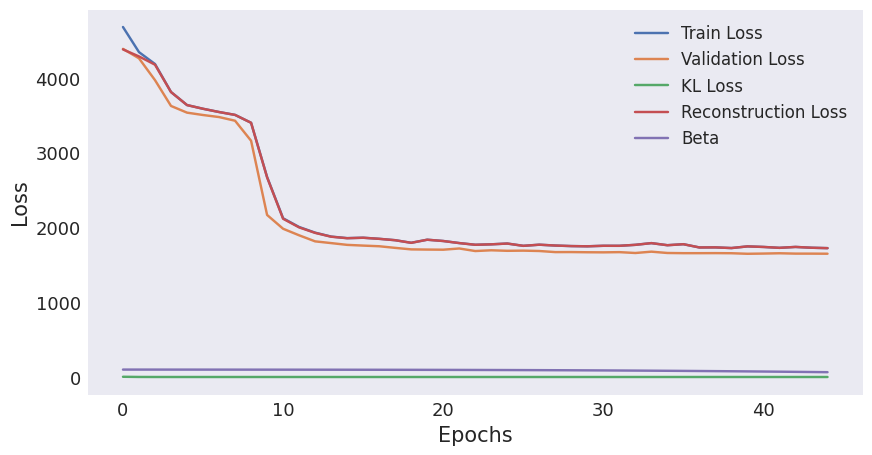

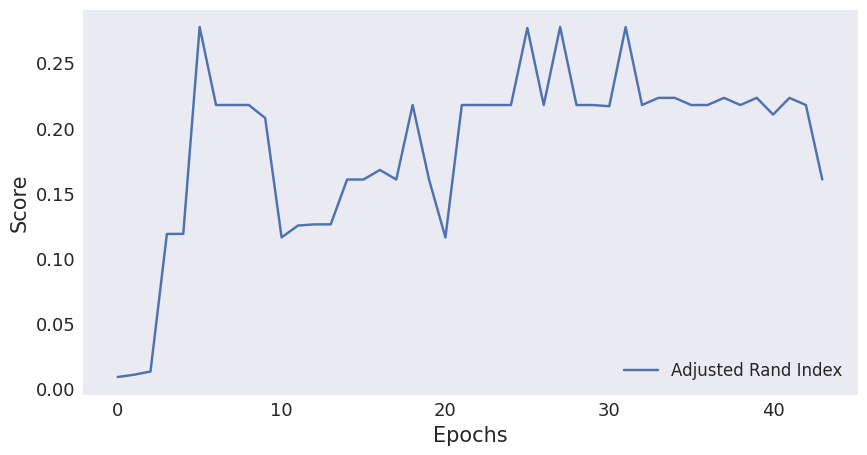

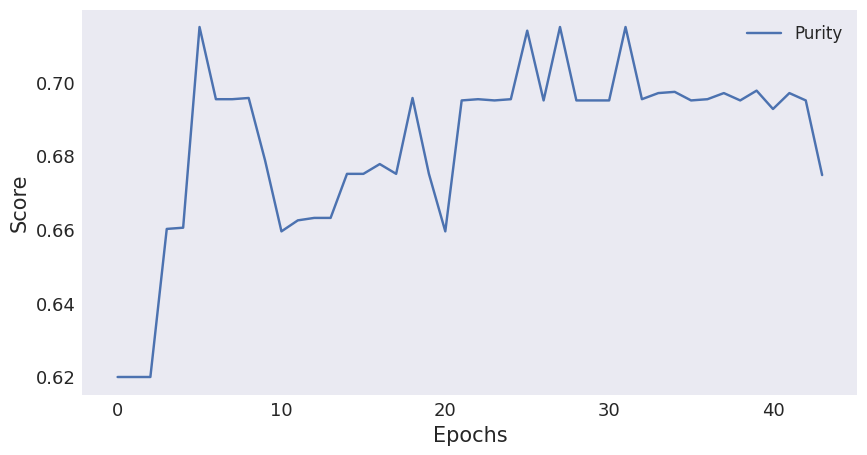

In [3]:
from models import variational
from models import train_vae, evaluate

encoder = variational.Encoder(num_layers, poolsize, channels,
                              kernel_sizes, dilations, activations)
decoder = variational.Decoder(encoder)
model = variational.AutoEncoder(encoder, decoder)

train_vae(model, train_data, val_data,
          lr=learning_rate,
          batch_size=batch_size,
          epochs=epochs)
# model = torch.load('./saved_models/variational_model.pt')
# evaluate(model, test_data,
#         batch_size=batch_size)

torch.save(model, './models/variational_model.pt')

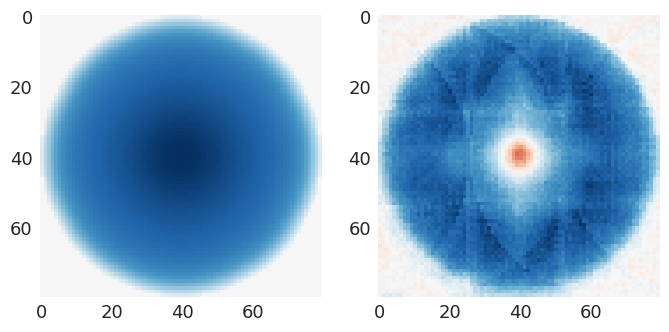

4_skyrmions


In [10]:
from plot import random_recon
random_recon(model, test_data)

In [5]:
import optuna
from sklearn.cluster import HDBSCAN
from cluster_acc import purity, adj_rand_index

feature_array = model.feature_array(sim_arr_tensor)

def objective(trial):
    hdbscan_model = HDBSCAN(min_cluster_size=trial.suggest_int('min_cluster_size', 2, 10),
                            min_samples=trial.suggest_int('min_samples', 1, 1000),
                            cluster_selection_epsilon=trial.suggest_float('cluster_selection_epsilon', 0.0, 1.0),
                            allow_single_cluster=True)
    hdbscan_model.fit(feature_array)
    labels = hdbscan_model.labels_
    return adj_rand_index(labels)
    
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

print(study.best_params)

hdbscan_model = HDBSCAN(min_cluster_size=study.best_params['min_cluster_size'],
                        min_samples=study.best_params['min_samples'],
                        cluster_selection_epsilon=study.best_params['cluster_selection_epsilon'],
                        allow_single_cluster=True)
hdbscan_model.fit(feature_array)
labels = hdbscan_model.labels_
print(f'Purity: {purity(labels)}')
print(f'ARI: {adj_rand_index(labels)}')

[I 2024-08-15 14:53:39,040] A new study created in memory with name: no-name-430d84f3-f4e9-4a62-800c-a0d4881fc82f
[I 2024-08-15 14:53:39,455] Trial 0 finished with value: -0.09307285558001042 and parameters: {'min_cluster_size': 6, 'min_samples': 765, 'cluster_selection_epsilon': 0.3743518602750654}. Best is trial 0 with value: -0.09307285558001042.
[I 2024-08-15 14:53:39,721] Trial 1 finished with value: 0.08204828080350687 and parameters: {'min_cluster_size': 10, 'min_samples': 440, 'cluster_selection_epsilon': 0.3708473075510893}. Best is trial 1 with value: 0.08204828080350687.
[I 2024-08-15 14:53:39,986] Trial 2 finished with value: 0.08736396848566239 and parameters: {'min_cluster_size': 6, 'min_samples': 436, 'cluster_selection_epsilon': 0.39371394896348677}. Best is trial 2 with value: 0.08736396848566239.
[I 2024-08-15 14:53:40,450] Trial 3 finished with value: 0.0 and parameters: {'min_cluster_size': 10, 'min_samples': 889, 'cluster_selection_epsilon': 0.1594507100361764}. Be

{'min_cluster_size': 6, 'min_samples': 1, 'cluster_selection_epsilon': 0.15336949752106682}
Purity: 0.9651162790697675
ARI: 0.9880038184446295


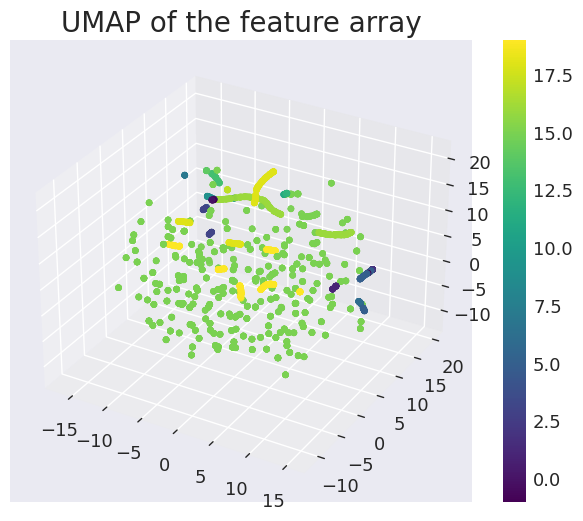

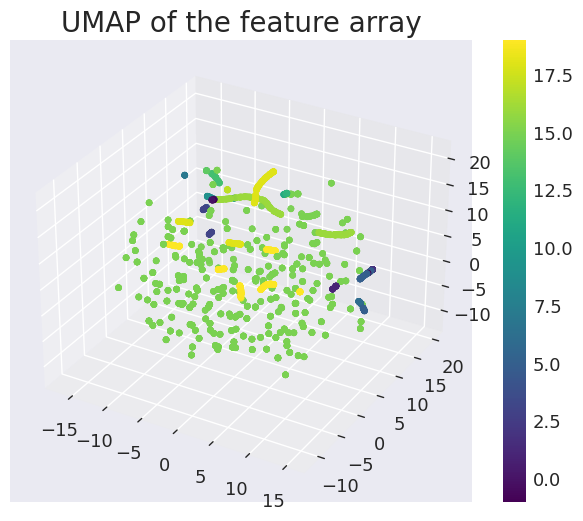

In [6]:
from plot import umap_plot
umap_plot(feature_array, labels)

In [7]:
from plot import class_config
class_config(labels)

Number of classes:  20


/home/tummalas/hyper-param-optim-4-vector-field-clustering/plot/plotting.py:214: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



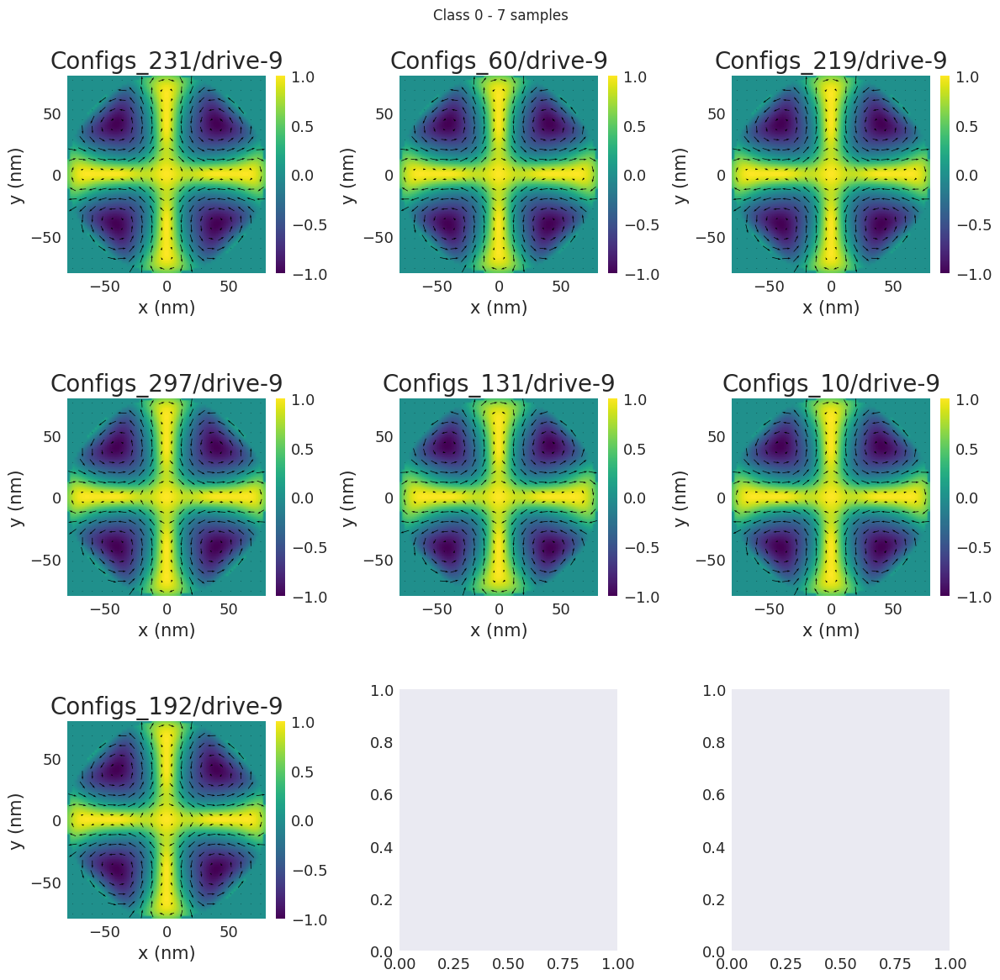

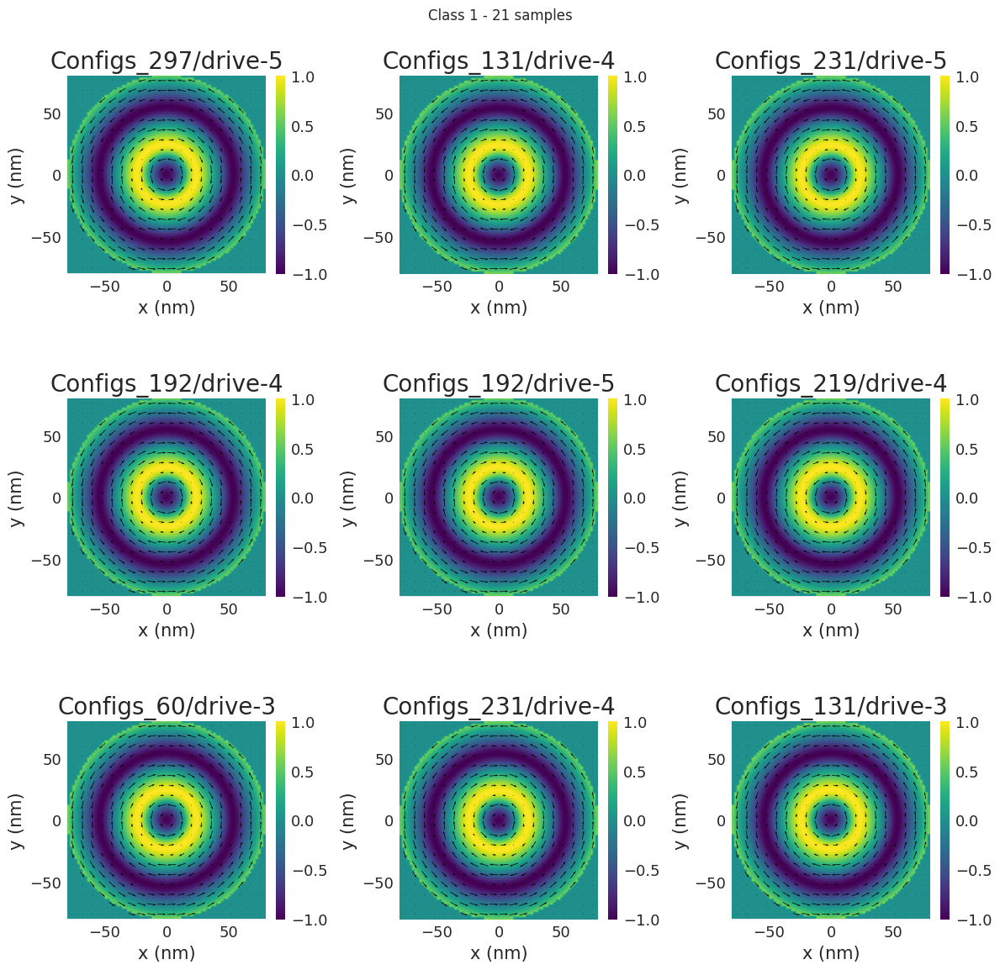

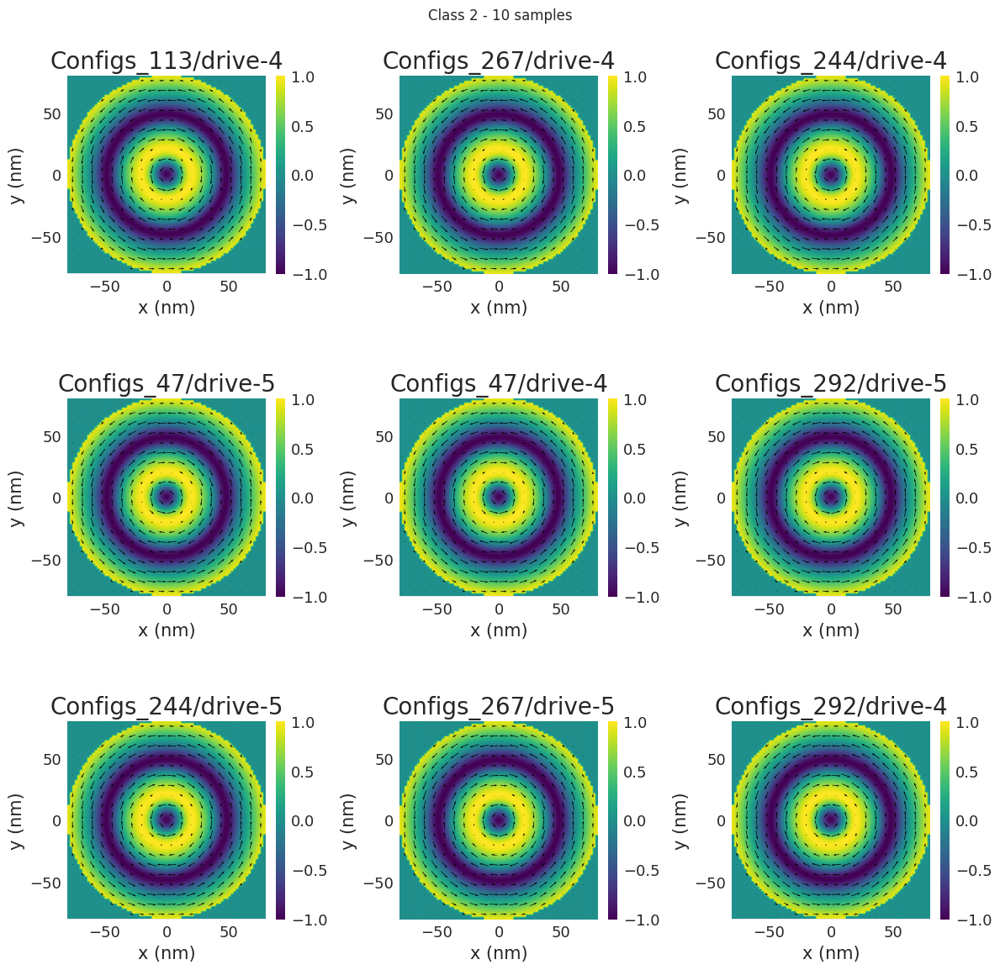

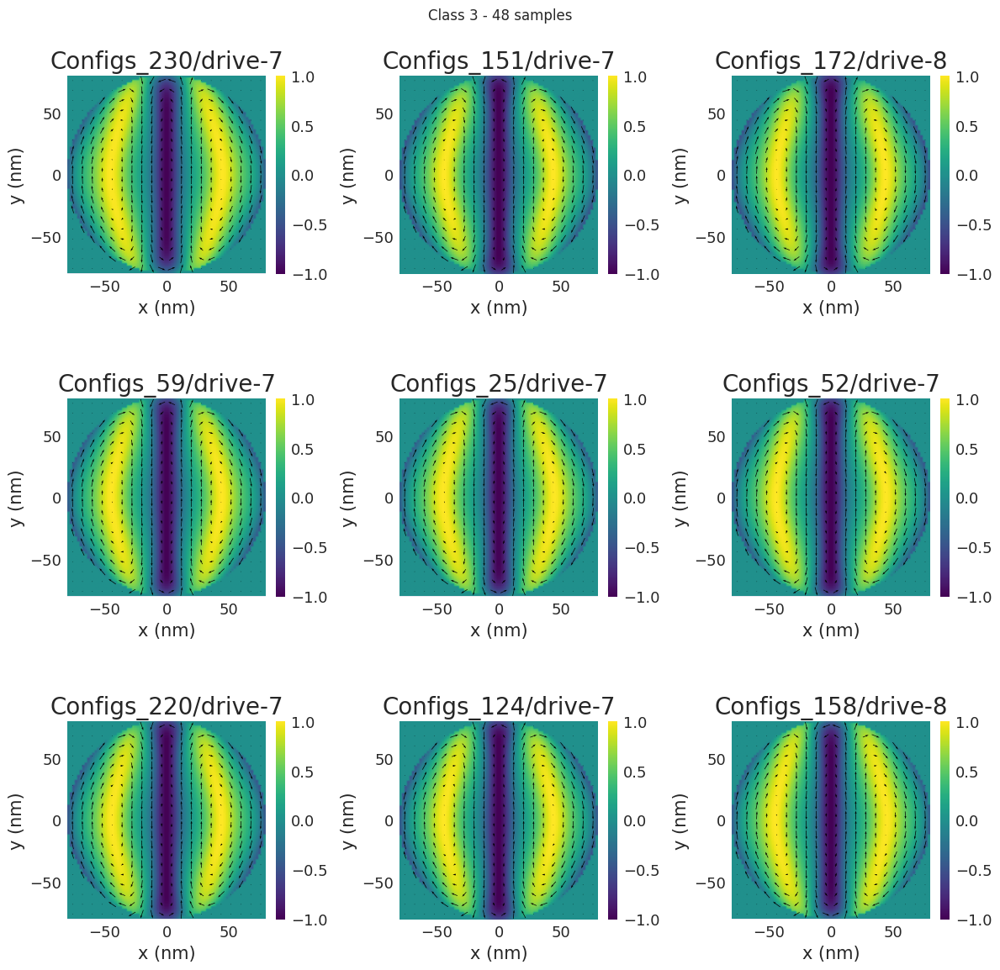

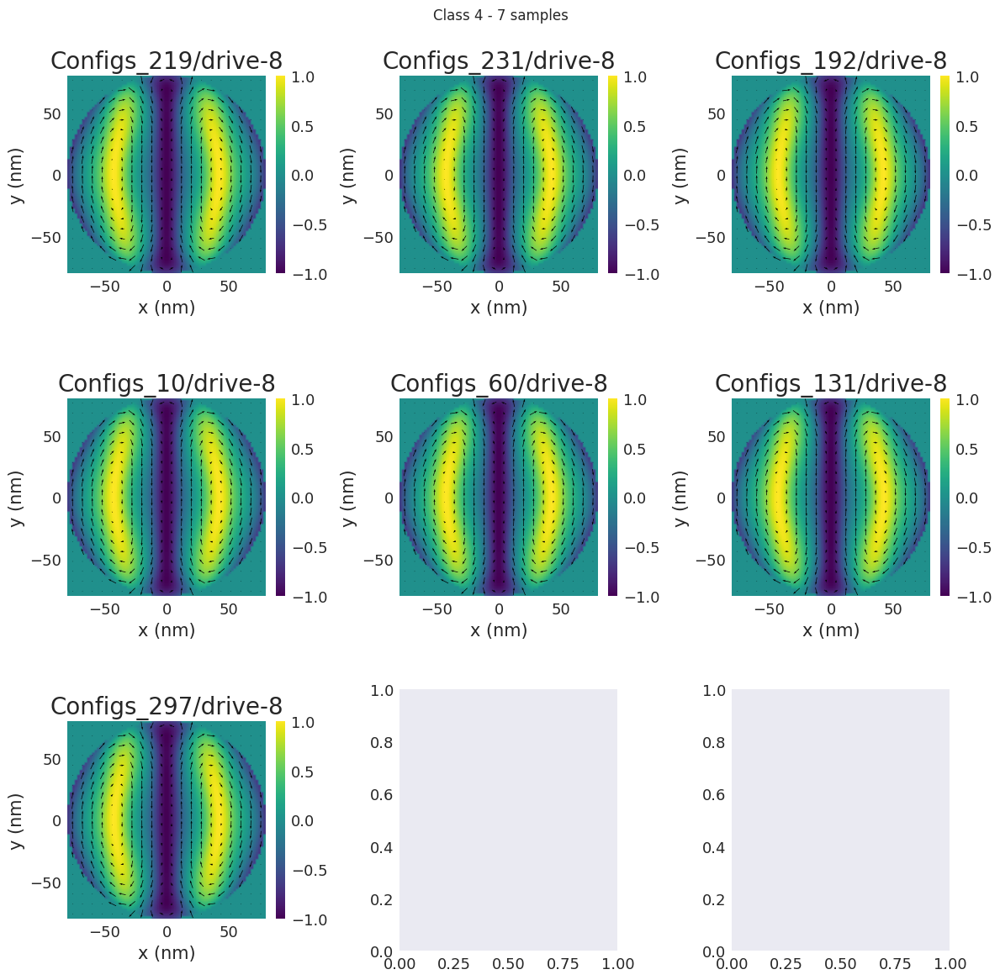

...

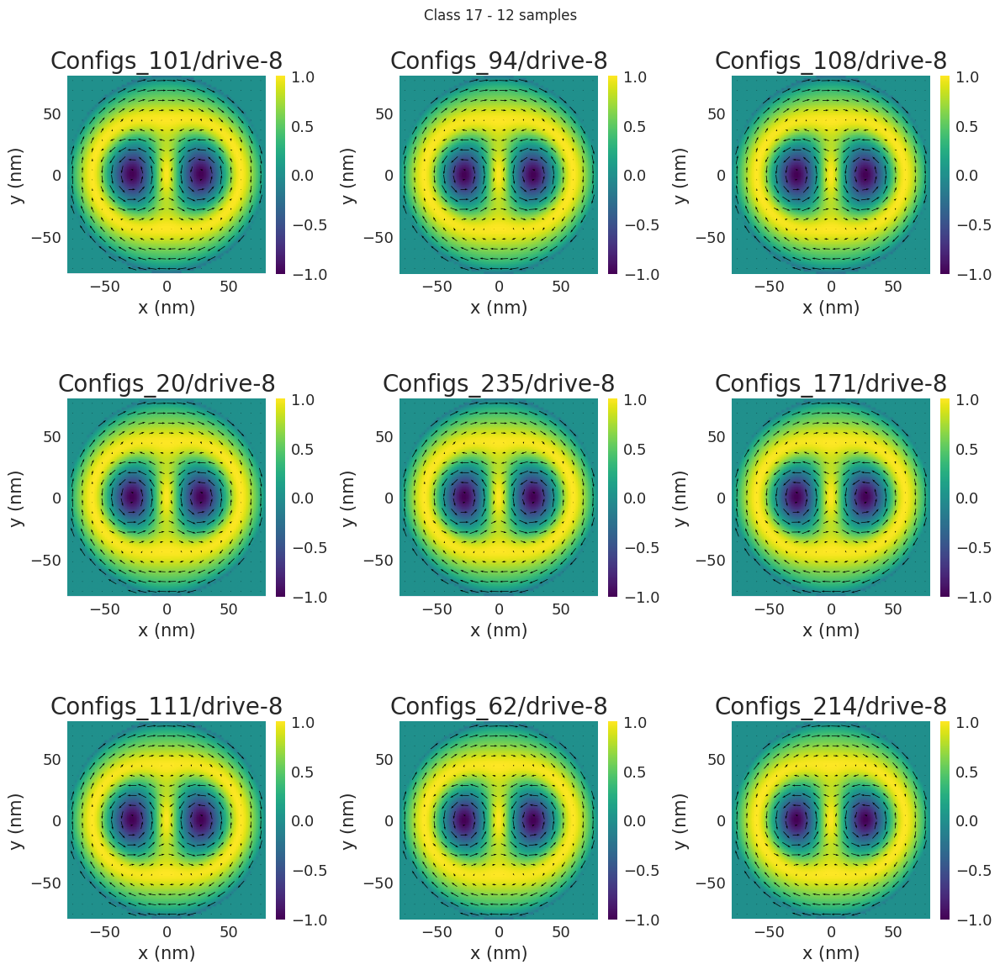

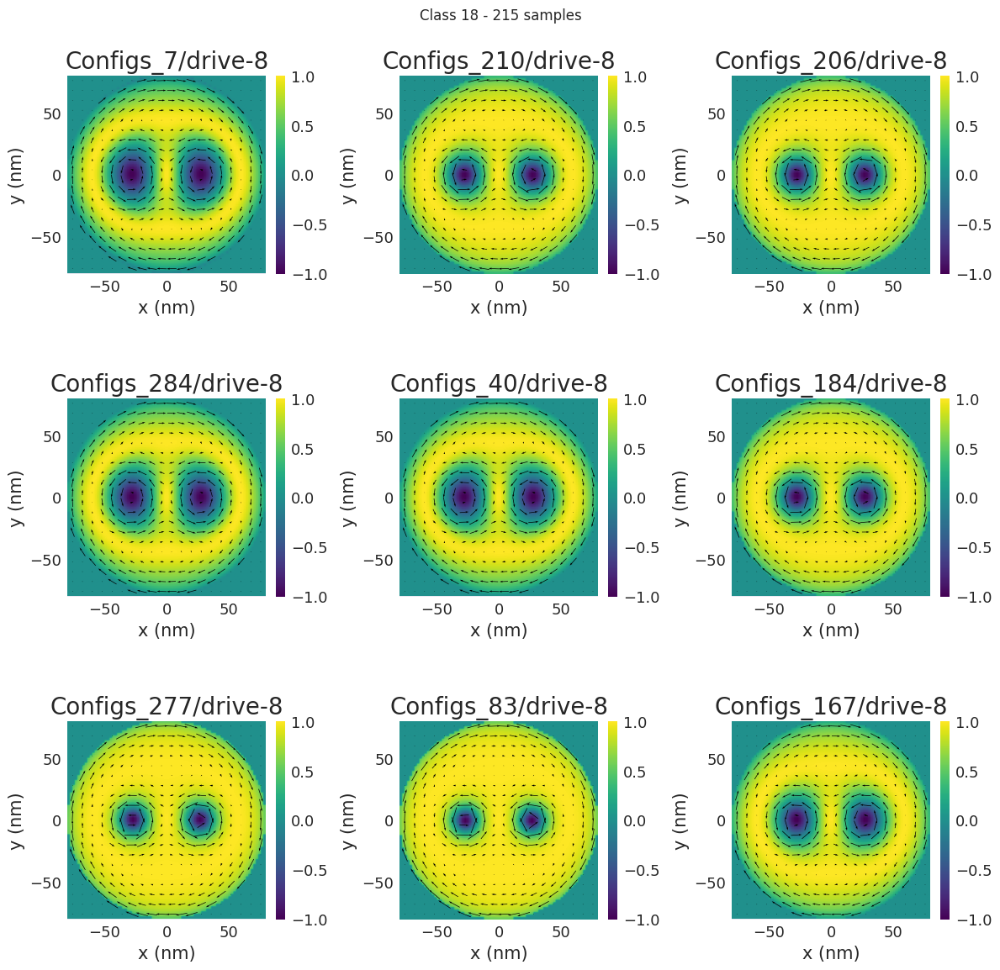

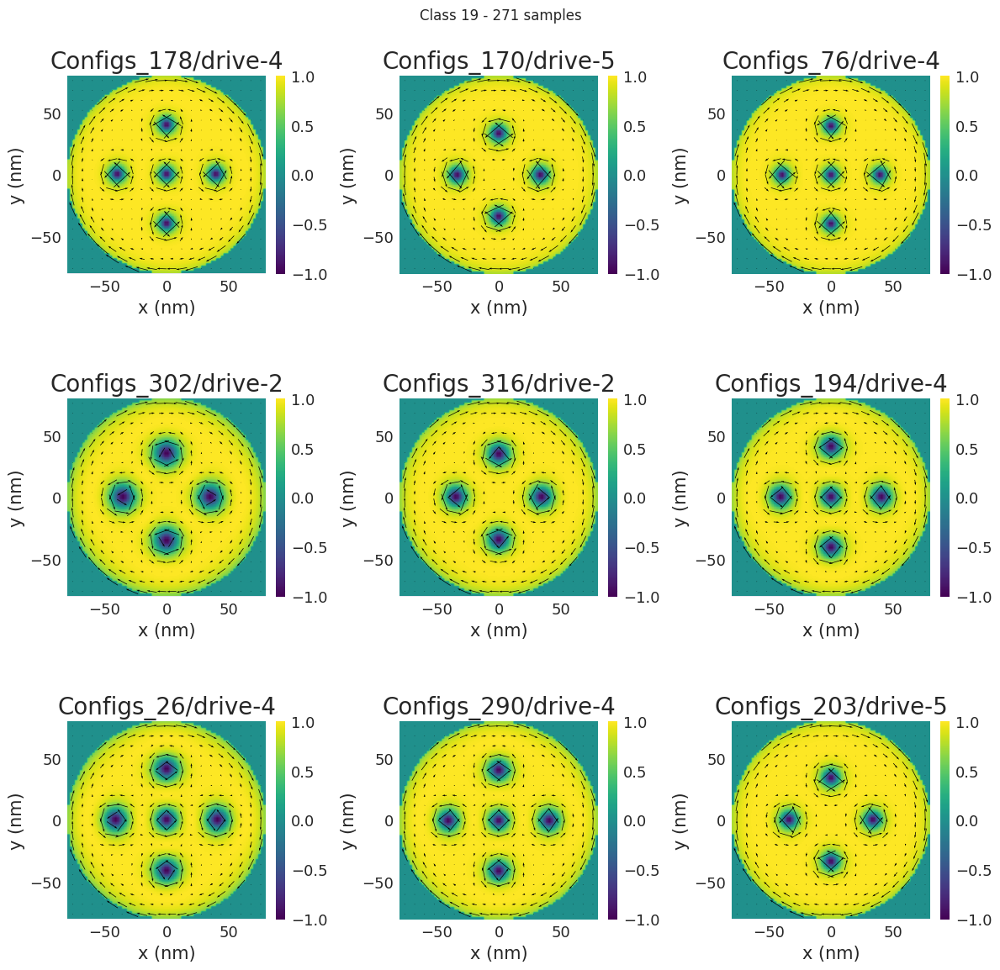

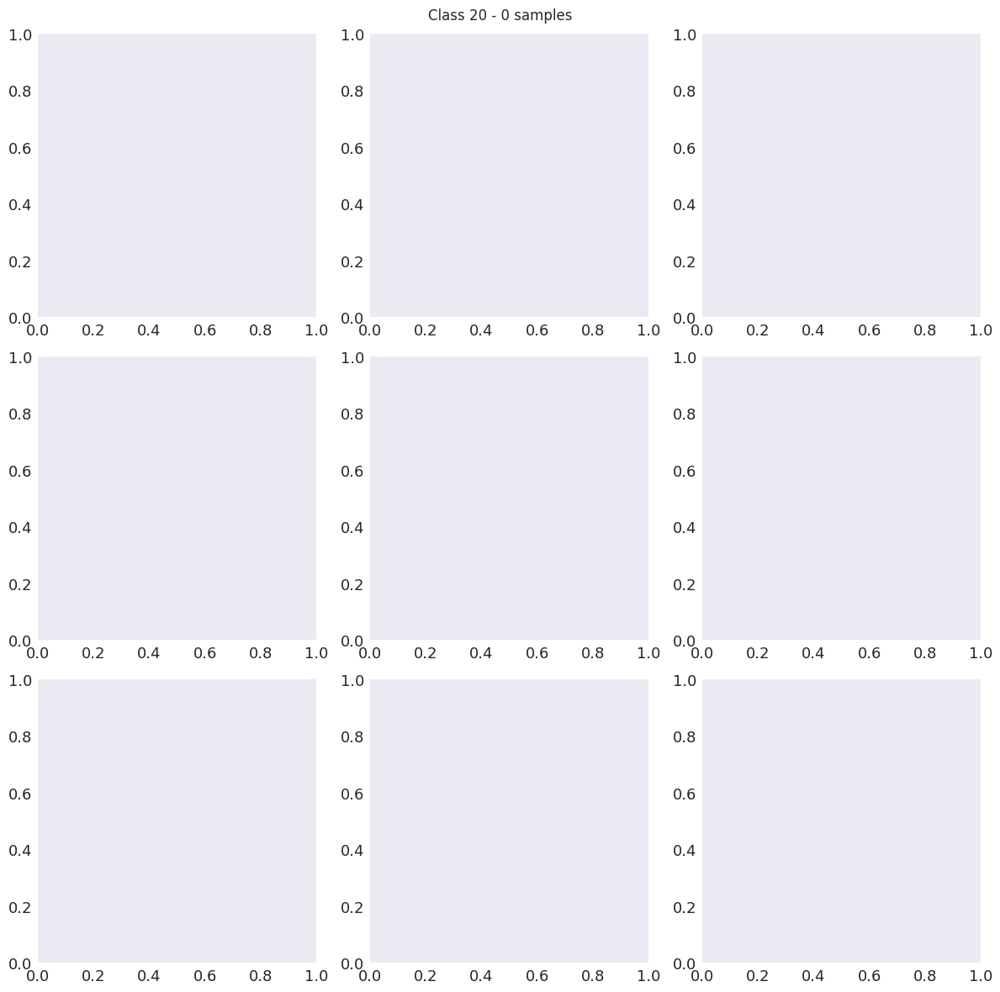

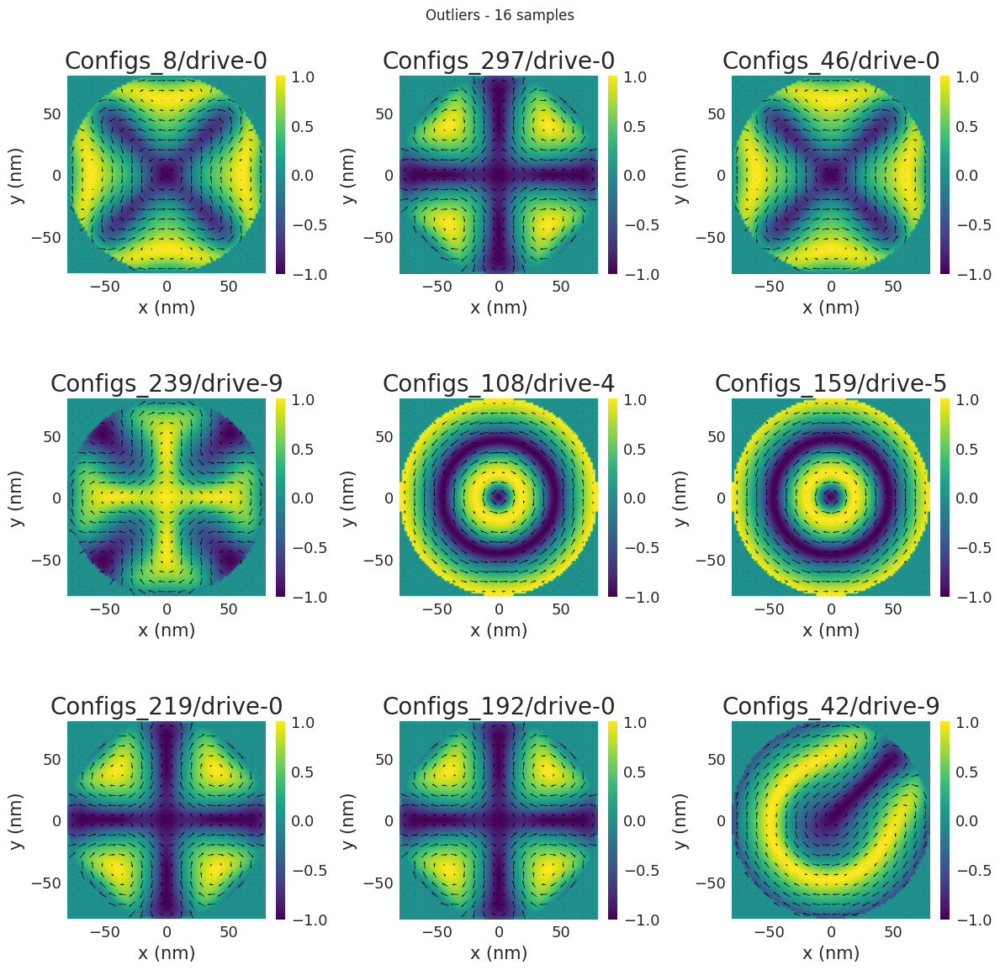

In [8]:
from plot import plot_all_examples
plot_all_examples(labels)